In [36]:
import numpy as np
import torch


In [37]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cuda


In [38]:
import timm
import torch

In [39]:
import math

import timm
import torch
import torch.nn as nn
import torch.nn.functional as F
from einops import rearrange
from safetensors import safe_open
from safetensors.torch import save_file
from timm.models.vision_transformer import VisionTransformer as timm_ViT
from torch import Tensor
from torch.nn.parameter import Parameter
import cv2
 



class _LoRALayer(nn.Module):
    def __init__(self, w: nn.Module, w_a_q: nn.Module, w_b_q: nn.Module, 
                                 w_a_v: nn.Module, w_b_v: nn.Module, r: int, alpha: int, dim:int):
        super().__init__()
        self.w = w

        
        self.w_a_q = w_a_q
        self.w_b_q = w_b_q
        
        self.w_a_v = w_a_v
        self.w_b_v = w_b_v
        
        self.r = r
        self.alpha = alpha
        self.dim = dim

    def forward(self, x):
        val = self.w(x)
        val[:,:,:self.dim] += (self.alpha // self.r) * self.w_b_q(self.w_a_q(x))
        val[:,:,self.dim*2:] += (self.alpha // self.r) * self.w_b_v(self.w_a_v(x))
        return val


class LoRA_ViT(nn.Module):


    def __init__(self, vit_model, r: int, alpha: int, num_classes: int = 0, lora_layer=None):
        super(LoRA_ViT, self).__init__()

        base_vit_dim = vit_model.blocks[0].attn.qkv.in_features
        dim = base_vit_dim
        if lora_layer:
            self.lora_layer = lora_layer
        else:
            self.lora_layer = list(range(len(vit_model.blocks)))
      
        self.w_As = nn.ModuleList()
        self.w_Bs = nn.ModuleList()


        for param in vit_model.parameters():
            param.requires_grad = False

        for t_layer_i, blk in enumerate(vit_model.blocks):
          
            if t_layer_i not in self.lora_layer:
                continue

            
            #w_q_linear = blk.attn.proj_q
            #w_v_linear = blk.attn.proj_v
            w_qkv_linear = blk.attn.qkv
            
            w_a_linear_q = nn.Linear(dim, r, bias=False)
            w_b_linear_q = nn.Linear(r, dim, bias=False)

            
            w_a_linear_v = nn.Linear(dim, r, bias=False)
            w_b_linear_v = nn.Linear(r, dim, bias=False)

            
            self.w_As.append(w_a_linear_q)
            self.w_Bs.append(w_b_linear_q)
            self.w_As.append(w_a_linear_v)
            self.w_Bs.append(w_b_linear_v)
            
            blk.attn.qkv = _LoRALayer(w_qkv_linear, w_a_linear_q, w_b_linear_q, w_a_linear_v, w_b_linear_v,r, alpha, dim)

        self.reset_parameters()
        self.lora_vit = vit_model

    def save_fc_parameters(self, filename: str) -> None:
        assert filename.endswith(".safetensors")
        _in = self.lora_vit.fc.in_features
        _out = self.lora_vit.fc.out_features
        fc_tensors = {f"fc_{_in}in_{_out}out": self.lora_vit.fc.weight}
        save_file(fc_tensors, filename)

    def reset_parameters(self) -> None:
        for w_A in self.w_As:
            nn.init.kaiming_uniform_(w_A.weight, a=math.sqrt(5))
        for w_B in self.w_Bs:
            nn.init.zeros_(w_B.weight)

    def forward(self, x: Tensor) -> Tensor:
        return self.lora_vit(x)

    def get_intermediate_layers(self, x: torch.Tensor, n,  reshape = False, return_class_token= False,norm=True):
        return self.lora_vit.get_intermediate_layers(x, n, reshape, return_class_token, norm)
        

In [48]:
import matplotlib.pyplot as plt
def plot_image_prediction_and_mask(image, prediction, mask):
    # Convert the image from BGR (OpenCV format) to RGB for display
    
    image_rgb = image.permute(1,2,0).cpu().numpy()[:,:,0]
    prediction = prediction.cpu().numpy()
    mask = mask.cpu().numpy()
    
    plt.figure(figsize=(15, 5))

    # Plot the original image
    plt.subplot(1, 3, 1)
    plt.imshow(image_rgb)
    plt.title("Image")
    plt.axis("off")

    # Plot the predicted mask
    plt.subplot(1, 3, 2)
    cmap_pred = 'gray' if len(prediction.shape) == 2 else None
    plt.imshow(prediction, cmap=cmap_pred)
    plt.title("Prediction")
    plt.axis("off")

    # Plot the ground truth mask
    plt.subplot(1, 3, 3)
    cmap_mask = 'gray' if len(mask.shape) == 2 else None
    plt.imshow(mask, cmap=cmap_mask)
    plt.title("Ground Truth Mask")
    plt.axis("off")

    plt.show()


In [49]:
import torchxrayvision as xrv
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
import kagglehub
from torchvision import datasets, transforms
from pathlib import Path
import torch   
import pandas as pd
from sklearn.model_selection import train_test_split


# Download latest version
path = kagglehub.dataset_download("beosup/lung-segment")

print("Path to dataset files:", path)


#Source: https://www.kaggle.com/code/akshar1812/lung-segmentation
class LungSegmentationDataset(Dataset):
    def __init__(self, df=None, base_dir=None, resize=None, transform=None, target_transform=None, both_transform=None):
        self.data = df
        self.base_dir = Path(base_dir)
        self.resize = resize
        self.transform = transform
        self.target_transform = target_transform
        self.both_transform=both_transform
    
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        img_relative_path = self.data.iloc[idx, 1]
        mask_relative_path = self.data.iloc[idx, 2]
        
        img_path = self.base_dir / img_relative_path
        mask_path = self.base_dir / mask_relative_path

        # Load image and mask using OpenCV
        image = cv2.imread(str(img_path), cv2.IMREAD_GRAYSCALE)
        image = np.stack([image] * 3, axis=-1)
        mask = cv2.imread(str(mask_path), cv2.IMREAD_GRAYSCALE)


        if self.transform:
            image = self.transform(image)

        if self.target_transform:
            mask = self.target_transform(mask)

        #print(torch.unique(mask))
        mask = mask.long()
        return image, mask

#
#image = torch.from_numpy(image).permute(2,0,1).float()


df_data = pd.read_csv(path + "/train.csv")

train_df, val_df = train_test_split(df_data, test_size=0.2, random_state=42) #THE ANSWER TO THE QUESTION




Path to dataset files: /home/jhk/.cache/kagglehub/datasets/beosup/lung-segment/versions/1


In [50]:
import os
from torchvision.transforms import InterpolationMode
#os.listdir(path)
#print(df_data)

transform_toTensor = transforms.Lambda(lambda x: torch.tensor(np.array(x), dtype=torch.uint8).unsqueeze(0))
#to_rgb = transforms.Lambda(lambda x: np.stack([x] * 3, axis=-1))



transform_train = transforms.Compose([
  #  to_rgb,
    transforms.ToTensor(),
    transforms.Resize((448, 448)),
    transforms.Normalize(mean=[0.4914, 0.4822, 0.4465],std = [0.1953, 0.1925, 0.1942]),
])
transform_train_mask = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((32, 32),interpolation=InterpolationMode.NEAREST_EXACT),
])


transform_val = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((448, 448)),
    transforms.Normalize(mean=[0.4914, 0.4822, 0.4465],std = [0.1953, 0.1925, 0.1942]),
])
transform_val_mask = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((448, 448), interpolation=InterpolationMode.NEAREST_EXACT),
])


In [56]:
#Training parameters
models = [] #Dino Frozen, DinoLora
rs =  [255, 0, 3, 5, 10, 20] #255 being a dummy class for the full optimization no LORA
num_classes = 2
learning_rate = 1e-2
num_epochs = 20
batch_size=16
num_layers = 1
input_dim = 384*num_layers
learning_rate = 1e-2
weight_decay = 1e-3
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


train_dataset = LungSegmentationDataset(df=train_df, base_dir=path, resize=448, 
                                                    transform=transform_train, target_transform=transform_train_mask)

val_dataset = LungSegmentationDataset(df=val_df, base_dir=path, resize=448, 
                                      transform=transform_val, target_transform=transform_val_mask)


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
print(len(train_dataset) + len(val_dataset))


704


In [44]:
#print(torch.max(train_dataset[1][1]))
class LinearHead(nn.Module):
    def __init__(self, dino, r ,in_features=1920, out_features=101, bias=True):
        super(LinearHead, self).__init__()
        self.linear = nn.Linear(in_features, out_features, bias)
        if r == 0:
            for param in dino.parameters():
                param.requires_grad = False
            self.lora_dino = dino
        elif r == 255:
            self.lora_dino = dino
        else:
            self.lora_dino = LoRA_ViT(dino, r=r, alpha=15, num_classes=0)
        
    def forward(self, imgs, num_layers):
        feature = self.lora_dino.get_intermediate_layers(imgs, num_layers, return_class_token=True)
        outputs = []
        for patch_idx in range(feature[0][0].shape[1]):
            patch_features = torch.cat([feature[layer_idx][0][:, patch_idx, :] for layer_idx in range(num_layers)], dim=-1)
            patch_output = self.linear(patch_features)
            outputs.append(patch_output)
        
        outputs = torch.stack(outputs, dim=1)
        return outputs



In [45]:
from torchvision import transforms
import torch.optim as optim
from torchmetrics import Dice
import cv2
import time

df = pd.DataFrame(columns=["r", "loss", "dice_metric", "trainable", "best_model", "time"])
for r in rs:
    dinov2_vits14 = torch.hub.load('facebookresearch/dinov2', 'dinov2_vits14')
    model = LinearHead(dinov2_vits14, r, input_dim, num_classes).to(device)
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.AdamW(filter(lambda a : a.requires_grad, model.parameters()), lr=learning_rate) 
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, num_epochs*len(train_loader.dataset), eta_min=0.0001)
    dice_metric = Dice(num_classes=2,ignore_index=0, threshold=0.5).to(device)

    
    num_trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print("trainable parameters", num_trainable_params)
    iteration = {"r": r, "loss": [], "dice_metric": [], "trainable":num_trainable_params , "best_model": None, "time":None}
    
    dice_metric_max = 0
    
    accum_time = 0
    for epoch in range(num_epochs):
        start = time.time()
        print("Current Epoch: ", epoch)
        model.train()
        running_loss = 0.0
        for i, (imgs, patch_labels) in enumerate(train_loader):
            imgs = imgs.to(device)
            patch_labels = patch_labels.to(device)
            
            outputs = model(imgs, num_layers)
            outputs = outputs.view(-1, num_classes)
            patch_labels = patch_labels.view(-1)
        
        
            loss = criterion(outputs, patch_labels)
        
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            scheduler.step()
        end = time.time()
        accum_time += end-start
        
        model.eval()
        dice_metric.reset()
        val_loss = 0.0
        with torch.no_grad():
            for i, (imgs, mask) in enumerate(val_loader):
                imgs = imgs.to(device)
                mask = mask.to(device).squeeze(1)
                
                outputs = model(imgs, num_layers)
    
                outputs = outputs.view(-1, num_classes)

                trans = transforms.Resize((32, 32),interpolation=InterpolationMode.NEAREST_EXACT)
                
                loss_mask = trans(mask).view(-1)
                loss = criterion(outputs, loss_mask)
                val_loss += loss.item()
    
    
                preds = torch.argmax(outputs, dim=1)
    
    
                preds = preds.view(-1, int(32), int(32))
                resize = transforms.Resize(mask.shape[2], interpolation=transforms.InterpolationMode.NEAREST_EXACT)
                
                preds = resize(preds)
                
                #patch_labels = patch_labels.view(-1, int(np.sqrt(feature[0][0].shape[1])), int(np.sqrt(feature[0][0].shape[1])))
    
    
                dice_metric.update(preds, mask)
                
            avg_val_loss = val_loss / len(val_loader)
            dice_metric_avg = dice_metric.compute().item()
            print("Dice average for epoch: ",dice_metric_avg)
            print("Average Loss: ", avg_val_loss)
            if dice_metric_avg > dice_metric_max:
                dice_metric_max = dice_metric_avg
                torch.save(model.state_dict(), f"model_r{r}_LUNG.pth")
            iteration["loss"].append(avg_val_loss)
            iteration["dice_metric"].append(dice_metric_avg)
    
    iteration["time"] = accum_time/num_epochs
    iteration_df = pd.DataFrame([iteration])
    df = pd.concat([df, iteration_df], ignore_index=True)

df.to_csv('results_lung_Segmentation.csv', index=False)

Using cache found in /home/jhk/.cache/torch/hub/facebookresearch_dinov2_main


trainable parameters 22057346
Current Epoch:  0
Dice average for epoch:  0.23756907880306244
Average Loss:  0.463134507338206
Current Epoch:  1
Dice average for epoch:  0.6230043172836304
Average Loss:  0.42801867259873283
Current Epoch:  2
Dice average for epoch:  0.0
Average Loss:  0.43755700521998936
Current Epoch:  3
Dice average for epoch:  0.5478556156158447
Average Loss:  0.4054216510719723
Current Epoch:  4
Dice average for epoch:  0.6294955611228943
Average Loss:  0.43869561288091874
Current Epoch:  5
Dice average for epoch:  0.6344167590141296
Average Loss:  0.4664122992091709
Current Epoch:  6
Dice average for epoch:  0.2461710423231125
Average Loss:  0.42345808611975777
Current Epoch:  7
Dice average for epoch:  0.0
Average Loss:  0.4400809639030033
Current Epoch:  8
Dice average for epoch:  0.17600437998771667
Average Loss:  0.4190773798359765
Current Epoch:  9
Dice average for epoch:  0.48778870701789856
Average Loss:  0.4017825954490238
Current Epoch:  10
Dice average fo

Using cache found in /home/jhk/.cache/torch/hub/facebookresearch_dinov2_main


trainable parameters 770
Current Epoch:  0
Dice average for epoch:  0.8985801339149475
Average Loss:  0.15033671094311607
Current Epoch:  1
Dice average for epoch:  0.9147994518280029
Average Loss:  0.0993014168408182
Current Epoch:  2
Dice average for epoch:  0.9189790487289429
Average Loss:  0.08252758449978298
Current Epoch:  3
Dice average for epoch:  0.9224259853363037
Average Loss:  0.07666886183950636
Current Epoch:  4
Dice average for epoch:  0.9229786992073059
Average Loss:  0.07684341486957338
Current Epoch:  5
Dice average for epoch:  0.9248788952827454
Average Loss:  0.07282623400290807
Current Epoch:  6
Dice average for epoch:  0.9243545532226562
Average Loss:  0.07437194221549565
Current Epoch:  7
Dice average for epoch:  0.9117438197135925
Average Loss:  0.09784480184316635
Current Epoch:  8
Dice average for epoch:  0.9247048497200012
Average Loss:  0.07514874719911152
Current Epoch:  9
Dice average for epoch:  0.9266850352287292
Average Loss:  0.06963634449574682
Curren

Using cache found in /home/jhk/.cache/torch/hub/facebookresearch_dinov2_main


trainable parameters 56066
Current Epoch:  0
Dice average for epoch:  0.0
Average Loss:  0.6086123519473605
Current Epoch:  1
Dice average for epoch:  0.0
Average Loss:  0.5651867257224189
Current Epoch:  2
Dice average for epoch:  0.0
Average Loss:  0.5645735992325677
Current Epoch:  3
Dice average for epoch:  0.0
Average Loss:  0.5648153954082065
Current Epoch:  4
Dice average for epoch:  0.0
Average Loss:  0.5699888004197015
Current Epoch:  5
Dice average for epoch:  0.0
Average Loss:  0.5710845390955607
Current Epoch:  6
Dice average for epoch:  0.0
Average Loss:  0.5664705899026659
Current Epoch:  7
Dice average for epoch:  0.0
Average Loss:  0.6002088718944125
Current Epoch:  8
Dice average for epoch:  0.24463748931884766
Average Loss:  0.6678261756896973
Current Epoch:  9
Dice average for epoch:  0.0
Average Loss:  0.5503987537489997
Current Epoch:  10
Dice average for epoch:  0.3405221104621887
Average Loss:  0.48857589231597054
Current Epoch:  11
Dice average for epoch:  0.566

Using cache found in /home/jhk/.cache/torch/hub/facebookresearch_dinov2_main


trainable parameters 92930
Current Epoch:  0
Dice average for epoch:  0.0
Average Loss:  0.5851779513888888
Current Epoch:  1
Dice average for epoch:  0.0
Average Loss:  0.5699393881691827
Current Epoch:  2
Dice average for epoch:  0.0
Average Loss:  0.5543520980411105
Current Epoch:  3
Dice average for epoch:  0.0
Average Loss:  1.5808840725156996
Current Epoch:  4
Dice average for epoch:  0.0
Average Loss:  0.5376786986986796
Current Epoch:  5
Dice average for epoch:  0.4268946349620819
Average Loss:  0.5063857833544413
Current Epoch:  6
Dice average for epoch:  0.5123453140258789
Average Loss:  0.45282623502943253
Current Epoch:  7
Dice average for epoch:  0.3551391661167145
Average Loss:  0.44882716404067147
Current Epoch:  8
Dice average for epoch:  0.6974256634712219
Average Loss:  0.34907524784406024
Current Epoch:  9
Dice average for epoch:  0.7604323625564575
Average Loss:  0.30116888218455845
Current Epoch:  10
Dice average for epoch:  0.7804714441299438
Average Loss:  0.2759

Using cache found in /home/jhk/.cache/torch/hub/facebookresearch_dinov2_main


trainable parameters 185090
Current Epoch:  0
Dice average for epoch:  0.0
Average Loss:  0.5687532623608907
Current Epoch:  1
Dice average for epoch:  0.0
Average Loss:  0.6308019558588663
Current Epoch:  2
Dice average for epoch:  0.0
Average Loss:  1.325716707441542
Current Epoch:  3
Dice average for epoch:  0.0
Average Loss:  0.5799229145050049
Current Epoch:  4
Dice average for epoch:  0.0
Average Loss:  0.563697463936276
Current Epoch:  5
Dice average for epoch:  0.0
Average Loss:  0.550258994102478
Current Epoch:  6
Dice average for epoch:  0.0007646451704204082
Average Loss:  0.6301934520403544
Current Epoch:  7
Dice average for epoch:  0.0
Average Loss:  0.5764400296741061
Current Epoch:  8
Dice average for epoch:  0.0
Average Loss:  0.5704068475299411
Current Epoch:  9
Dice average for epoch:  0.0
Average Loss:  0.5623652338981628
Current Epoch:  10
Dice average for epoch:  0.0
Average Loss:  0.5704708364274766
Current Epoch:  11
Dice average for epoch:  0.0
Average Loss:  0.

Using cache found in /home/jhk/.cache/torch/hub/facebookresearch_dinov2_main


trainable parameters 369410
Current Epoch:  0
Dice average for epoch:  0.8959745764732361
Average Loss:  0.16265665822558933
Current Epoch:  1
Dice average for epoch:  0.9139136075973511
Average Loss:  0.10095998562044567
Current Epoch:  2
Dice average for epoch:  0.9207556843757629
Average Loss:  0.08059063057104747
Current Epoch:  3
Dice average for epoch:  0.9227623343467712
Average Loss:  0.07615033288796742
Current Epoch:  4
Dice average for epoch:  0.9230581521987915
Average Loss:  0.07525494777494007
Current Epoch:  5
Dice average for epoch:  0.924639105796814
Average Loss:  0.07467053499486712
Current Epoch:  6
Dice average for epoch:  0.9243906736373901
Average Loss:  0.07289958745241165
Current Epoch:  7
Dice average for epoch:  0.9257996678352356
Average Loss:  0.07109969606002171
Current Epoch:  8
Dice average for epoch:  0.926344096660614
Average Loss:  0.07042061827248997
Current Epoch:  9
Dice average for epoch:  0.9225274920463562
Average Loss:  0.07615581817097133
Curr

110.87087661027908
91.15876222848892
117.9020561337471
116.37788963317873
117.51650040149688
117.18360981941224


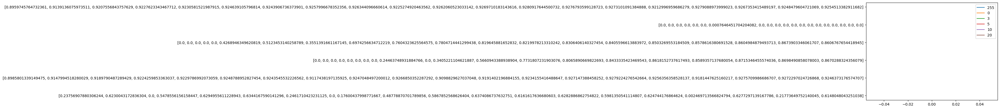

In [46]:
df = pd.read_csv('results_lung_Segmentation.csv')
for idx, i in df.iterrows():
    print(i["time"])
    plt.figure(2)
    plt.plot(i["dice_metric"], label=i["r"])
    plt.legend()


Using cache found in /home/jhk/.cache/torch/hub/facebookresearch_dinov2_main


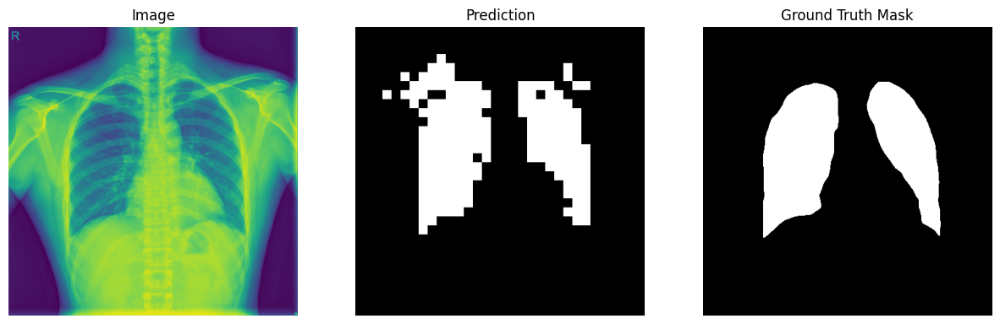

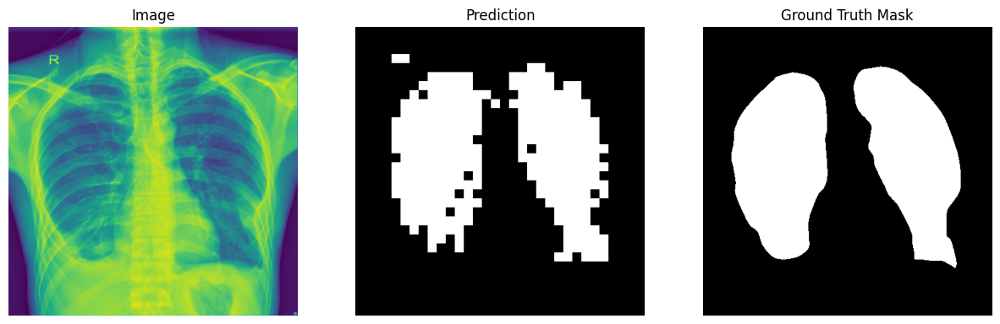

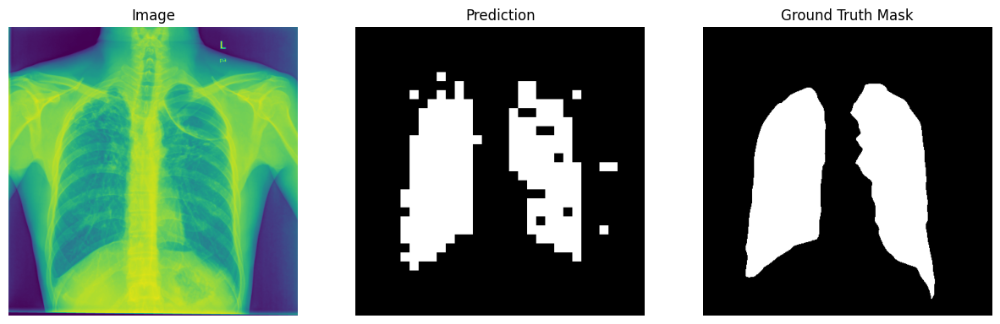

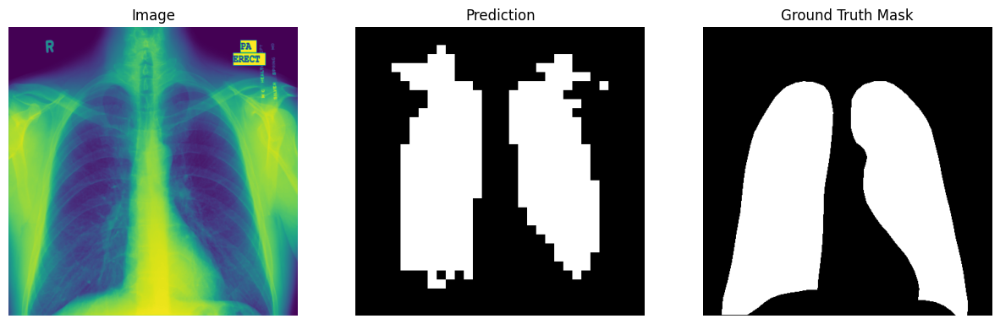

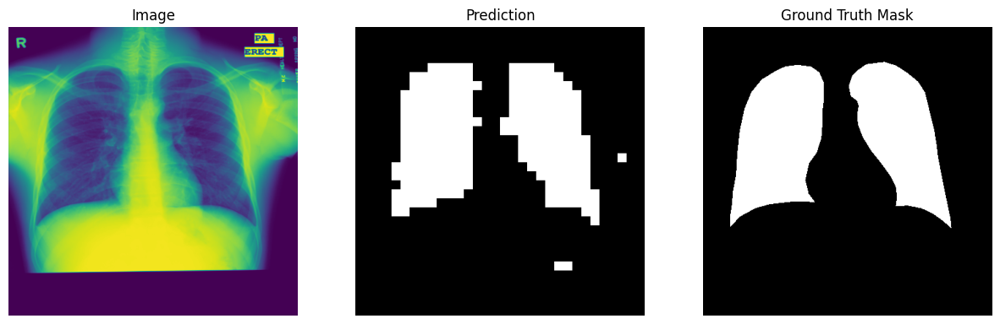

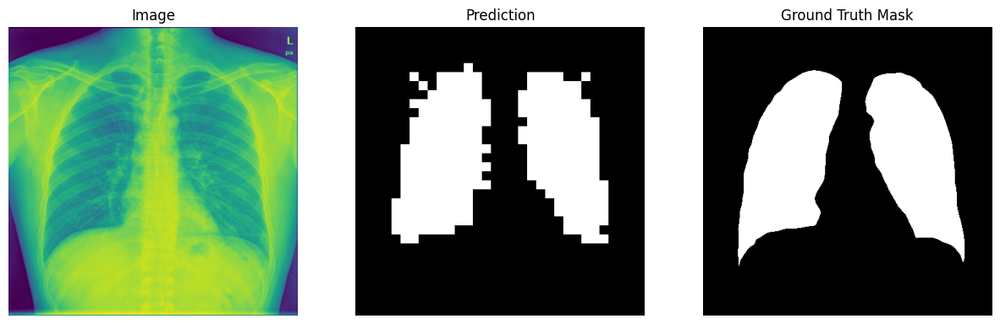

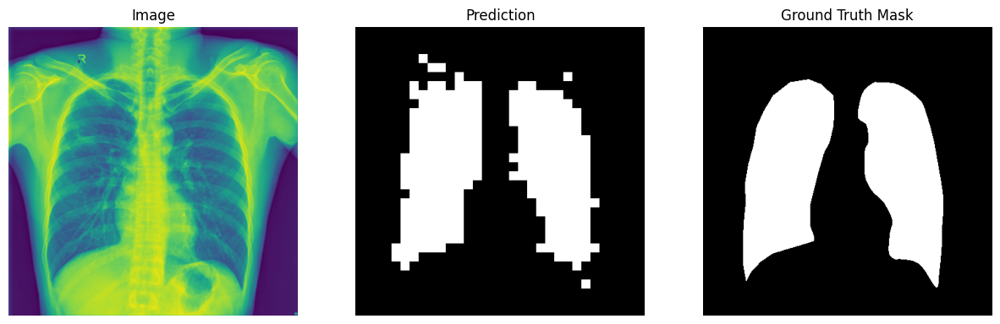

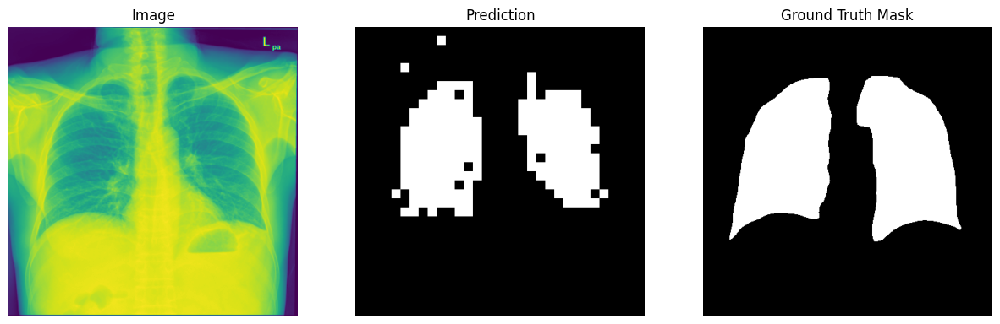

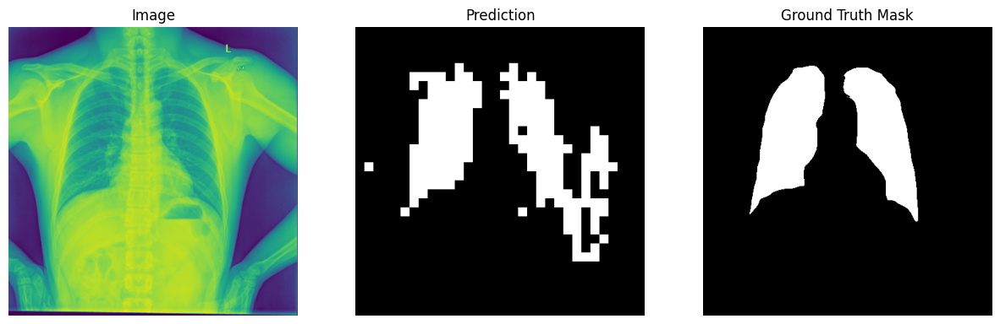

In [47]:
dinov2_vits14 = torch.hub.load('facebookresearch/dinov2', 'dinov2_vits14')
model = LinearHead(dinov2_vits14, 3, input_dim, 2).to(device)
model.load_state_dict(torch.load("model_r3_LUNG.pth"))
with torch.no_grad():
    for i, (imgs, mask) in enumerate(val_loader):
        if i > 10:
            break
        imgs = imgs.to(device)
        mask = mask.to(device).squeeze(1)
        
        outputs = model(imgs, num_layers)

        outputs = outputs.view(-1, num_classes)
        preds = torch.argmax(outputs, dim=1)



        preds = preds.view(-1, int(32), int(32))
        
        resize = transforms.Resize(mask.shape[2], interpolation=transforms.InterpolationMode.NEAREST_EXACT)
        
        preds = resize(preds)

        plot_image_prediction_and_mask(imgs[0], preds[0], mask[0])

In [57]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("sabahesaraki/breast-ultrasound-images-dataset")

print("Path to dataset files:", path)

Path to dataset files: /home/jhk/.cache/kagglehub/datasets/sabahesaraki/breast-ultrasound-images-dataset/versions/1


In [58]:
rs =  [255, 0, 3, 5, 10, 20] #255 being a dummy class for the full optimization no LORA
num_classes = 3
learning_rate = 1e-2
num_epochs = 40
batch_size=16
num_layers = 1
input_dim = 384*num_layers
learning_rate = 1e-2
weight_decay = 1e-3
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [59]:
#print(torch.max(train_dataset[1][1]))
class LinearHead(nn.Module):
    def __init__(self, dino, r ,in_features=1920, out_features=101, bias=True):
        super(LinearHead, self).__init__()
        self.linear = nn.Linear(in_features, out_features, bias)
        if r == 0:
            for param in dino.parameters():
                param.requires_grad = False
            self.lora_dino = dino
        elif r == 255:
            self.lora_dino = dino
        else:
            self.lora_dino = LoRA_ViT(dino, r=r, alpha=15, num_classes=0)
        
    def forward(self, imgs, num_layers):
        feature = self.lora_dino.get_intermediate_layers(imgs, num_layers, return_class_token=True)
        outputs = []
        for patch_idx in range(feature[0][0].shape[1]):
            patch_features = torch.cat([feature[layer_idx][0][:, patch_idx, :] for layer_idx in range(num_layers)], dim=-1)
            patch_output = self.linear(patch_features)
            outputs.append(patch_output)
        
        outputs = torch.stack(outputs, dim=1)
        return outputs

In [60]:
map_to_class = {
    "normal" : 0,
    "benign" : 1,
    "malignant": 2,}
import albumentations as A
from torchvision.transforms import InterpolationMode

class BreastTumorDataset(Dataset):
    def __init__(self, dataset=None, base_dir=None, transform=None, target_transform=None, both_transform=None):
        self.data = dataset
        self.base_dir = Path(base_dir)
        self.transform = transform
        self.target_transform = target_transform
        self.both_transform=both_transform
    
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        class_tumor, index = self.data[idx]
        img_relative_path = f"{class_tumor}/" + f"{class_tumor} ({index}).png"
        mask_relative_path = f"{class_tumor}/" + f"{class_tumor} ({index})_mask.png"
        
        
        img_path = self.base_dir / img_relative_path
        mask_path = self.base_dir / mask_relative_path
        

        # Load image and mask using OpenCV
        image = cv2.imread(str(img_path), cv2.IMREAD_GRAYSCALE)
        image = np.stack([image] * 3, axis=-1)
        mask = cv2.imread(str(mask_path), cv2.IMREAD_GRAYSCALE)
        counter = 1
        while True:
            if os.path.exists(str(self.base_dir) + f"/{class_tumor}/" + f"{class_tumor} ({index})_mask_{counter}.png"):
                mask2 = cv2.imread(str(self.base_dir) + f"/{class_tumor}/" + f"{class_tumor} ({index})_mask_{counter}.png", cv2.IMREAD_GRAYSCALE)
                mask += mask2 
                counter+=1
            else:
                break

        mask = np.where(mask == 255, map_to_class[class_tumor], 0)  

        if self.both_transform:
            transformed = self.both_transform(image=image, mask=mask)
            mask = transformed["mask"]
            image = transformed["image"]
        
        if self.transform:
            image = self.transform(image)

        if self.target_transform:
            mask = self.target_transform(mask)

        
        mask = mask.long() 
        return image, mask


In [61]:
import re
import os
import albumentations as A


base_path = "/home/jhk/.cache/kagglehub/datasets/sabahesaraki/breast-ultrasound-images-dataset/versions/1/Dataset_BUSI_with_GT"
pattern = r'\((\d+)\)\.png$'
dataset = []
for path in os.listdir(base_path):
    class_of_tumor = path
    in_class = []
    for number in os.listdir(base_path + "/" + path):
        match = re.search(pattern, number)
        if not (match == None):
            val = match.group(1)
            dataset.append((path, val))


transform_train = transforms.Compose([
  #  to_rgb,
    transforms.ToTensor(),
    transforms.Resize((448, 448)),
    transforms.Normalize(mean=[0.4914, 0.4822, 0.4465],std = [0.1953, 0.1925, 0.1942]),
])
transform_train_mask = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((32, 32),interpolation=InterpolationMode.NEAREST_EXACT),
])


transform_val = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((448, 448)),
    transforms.Normalize(mean=[0.4914, 0.4822, 0.4465],std = [0.1953, 0.1925, 0.1942]),
])
transform_val_mask = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((448, 448), interpolation=InterpolationMode.NEAREST_EXACT),
])



both_transform = A.Compose([
    A.RandomCrop(width=256, height=256, p=0.3),  # Randomly crop both image and mask
    A.HorizontalFlip(p=0.5),                      # Random horizontal flip
    A.VerticalFlip(p=0.5),                        # Random vertical flip                             # Convert to PyTorch tensors
])


train_val, test = train_test_split(dataset, test_size=0.2, random_state=42)
train_dataset = BreastTumorDataset(train_val, base_dir=base_path, transform=transform_train, target_transform=transform_train_mask, both_transform=both_transform)#, both_transform=both_transform)
val_dataset = BreastTumorDataset(test, base_dir=base_path, transform=transform_train, target_transform=transform_val_mask)


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
print(len(train_dataset) + len(val_dataset))

780


In [18]:
from torchvision import transforms
import torch.optim as optim
from torchmetrics import Dice
import cv2
import time
from torchvision.ops import sigmoid_focal_loss
from monai.losses import DiceFocalLoss

df = pd.DataFrame(columns=["r", "loss", "dice_metric", "trainable", "best_model", "time", "LR"])
for r in rs:
    dinov2_vits14 = torch.hub.load('facebookresearch/dinov2', 'dinov2_vits14')
    model = LinearHead(dinov2_vits14, r, input_dim, num_classes).to(device)
    
    
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.SGD(filter(lambda a : a.requires_grad, model.parameters()), lr=learning_rate)

    #scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, num_epochs, eta_min=0.001)
    dice_metric = Dice(num_classes=3, ignore_index=0, threshold=0.5).to(device)

    
    num_trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print("trainable parameters", num_trainable_params)
    iteration = {"r": r, "loss": [], "dice_metric": [], "trainable":num_trainable_params , "best_model": None, "time":None, "LR":None}
    
    dice_metric_max = 0
    
    accum_time = 0
    for epoch in range(num_epochs):
        start = time.time()
        print("Current Epoch: ", epoch)
        model.train()
        running_loss = 0.0
        for i, (imgs, patch_labels) in enumerate(train_loader):
            imgs = imgs.to(device)
            patch_labels = patch_labels.to(device)
            
            outputs = model(imgs, num_layers)
            outputs = outputs.view(-1, num_classes)
            
            patch_labels = patch_labels.view(-1)
        
        
            loss = criterion(outputs, patch_labels)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            current_lr = optimizer.param_groups[0]['lr']
        end = time.time()
        accum_time += end-start
        model.eval()
        dice_metric.reset()
        val_loss = 0.0
        with torch.no_grad():
            for i, (imgs, mask) in enumerate(val_loader):
                imgs = imgs.to(device)
                
                mask = mask.to(device).squeeze(1)
                
                outputs = model(imgs, num_layers)
    
                outputs = outputs.view(-1, num_classes)

                trans = transforms.Resize((32, 32),interpolation=InterpolationMode.NEAREST_EXACT)
                
                loss_mask = trans(mask).view(-1)
                loss = criterion(outputs, loss_mask)
                val_loss += loss.item()
    
    
                preds = torch.argmax(outputs, dim=1)
    
    
                preds = preds.view(-1, int(32), int(32))
                resize = transforms.Resize(mask.shape[2], interpolation=transforms.InterpolationMode.NEAREST_EXACT)
                
                preds = resize(preds)
                
                #patch_labels = patch_labels.view(-1, int(np.sqrt(feature[0][0].shape[1])), int(np.sqrt(feature[0][0].shape[1])))
    
    
                dice_metric.update(preds, mask)
                
            avg_val_loss = val_loss / len(val_loader)
            dice_metric_avg = dice_metric.compute().item()
            print("Dice average for epoch: ",dice_metric_avg)
            print("Average Loss: ", avg_val_loss)
            if dice_metric_avg > dice_metric_max:
                dice_metric_max = dice_metric_avg
                torch.save(model.state_dict(), f"model_{r}_CANCER.pth")
            iteration["loss"].append(avg_val_loss)
            iteration["dice_metric"].append(dice_metric_avg)
    
    
    iteration["time"] = accum_time/num_epochs
    iteration["LR"] = lr
    iteration_df = pd.DataFrame([iteration])
    df = pd.concat([df, iteration_df], ignore_index=True)

df.to_csv('results3.csv', index=False)

Using cache found in /home/jhk/.cache/torch/hub/facebookresearch_dinov2_main


trainable parameters 22057731
Current Epoch:  0
Dice average for epoch:  0.0
Average Loss:  0.337391197681427
Current Epoch:  1
Dice average for epoch:  0.0
Average Loss:  0.3085023745894432
Current Epoch:  2
Dice average for epoch:  0.0
Average Loss:  0.3074029177427292
Current Epoch:  3
Dice average for epoch:  0.0
Average Loss:  0.31177151799201963
Current Epoch:  4
Dice average for epoch:  0.0
Average Loss:  0.3225958839058876
Current Epoch:  5
Dice average for epoch:  0.0
Average Loss:  0.30694016963243487
Current Epoch:  6
Dice average for epoch:  0.0
Average Loss:  0.3077889770269394
Current Epoch:  7
Dice average for epoch:  0.0
Average Loss:  0.3110355958342552
Current Epoch:  8
Dice average for epoch:  0.0
Average Loss:  0.30621301382780075
Current Epoch:  9
Dice average for epoch:  0.0
Average Loss:  0.31940336972475053
Current Epoch:  10
Dice average for epoch:  0.0
Average Loss:  0.3123557776212692
Current Epoch:  11
Dice average for epoch:  0.0
Average Loss:  0.3719191223

Using cache found in /home/jhk/.cache/torch/hub/facebookresearch_dinov2_main


trainable parameters 1155
Current Epoch:  0
Dice average for epoch:  0.3316759467124939
Average Loss:  0.2387704998254776
Current Epoch:  1
Dice average for epoch:  0.3839813768863678
Average Loss:  0.2149351179599762
Current Epoch:  2
Dice average for epoch:  0.3231410086154938
Average Loss:  0.20417102724313735
Current Epoch:  3
Dice average for epoch:  0.41177019476890564
Average Loss:  0.2072945311665535
Current Epoch:  4
Dice average for epoch:  0.3791247308254242
Average Loss:  0.19565785974264144
Current Epoch:  5
Dice average for epoch:  0.3392584025859833
Average Loss:  0.19512192904949188
Current Epoch:  6
Dice average for epoch:  0.4484977722167969
Average Loss:  0.18982985094189644
Current Epoch:  7
Dice average for epoch:  0.4052255153656006
Average Loss:  0.18991748616099358
Current Epoch:  8
Dice average for epoch:  0.4156627357006073
Average Loss:  0.18510894924402238
Current Epoch:  9
Dice average for epoch:  0.492298424243927
Average Loss:  0.21398384720087052
Current

Using cache found in /home/jhk/.cache/torch/hub/facebookresearch_dinov2_main


trainable parameters 56451
Current Epoch:  0
Dice average for epoch:  0.25608474016189575
Average Loss:  0.21175949573516845
Current Epoch:  1
Dice average for epoch:  0.4509305953979492
Average Loss:  0.18245237171649933
Current Epoch:  2
Dice average for epoch:  0.5141530632972717
Average Loss:  0.2025809668004513
Current Epoch:  3
Dice average for epoch:  0.5519585013389587
Average Loss:  0.16203006953001023
Current Epoch:  4
Dice average for epoch:  0.5762731432914734
Average Loss:  0.16078801229596137
Current Epoch:  5
Dice average for epoch:  0.5331963300704956
Average Loss:  0.1722169853746891
Current Epoch:  6
Dice average for epoch:  0.4871140718460083
Average Loss:  0.17333204820752143
Current Epoch:  7
Dice average for epoch:  0.5103355050086975
Average Loss:  0.16735013648867608
Current Epoch:  8
Dice average for epoch:  0.5326114892959595
Average Loss:  0.14906332939863204
Current Epoch:  9
Dice average for epoch:  0.604505181312561
Average Loss:  0.14747097417712213
Curre

Using cache found in /home/jhk/.cache/torch/hub/facebookresearch_dinov2_main


Dice average for epoch:  0.2659829258918762
Average Loss:  0.23237543553113937
Current Epoch:  1
Dice average for epoch:  0.3549550175666809
Average Loss:  0.1984492175281048
Current Epoch:  2
Dice average for epoch:  0.4426229000091553
Average Loss:  0.19047653451561927
Current Epoch:  3
Dice average for epoch:  0.5430477261543274
Average Loss:  0.17972823828458787
Current Epoch:  4
Dice average for epoch:  0.45059019327163696
Average Loss:  0.19326589331030847
Current Epoch:  5
Dice average for epoch:  0.49736258387565613
Average Loss:  0.16781629994511604
Current Epoch:  6
Dice average for epoch:  0.500964879989624
Average Loss:  0.16668344661593437
Current Epoch:  7
Dice average for epoch:  0.5362762808799744
Average Loss:  0.1534968987107277
Current Epoch:  8
Dice average for epoch:  0.5696802735328674
Average Loss:  0.16059783175587655
Current Epoch:  9
Dice average for epoch:  0.5484311580657959
Average Loss:  0.16067352443933486
Current Epoch:  10
Dice average for epoch:  0.532

Using cache found in /home/jhk/.cache/torch/hub/facebookresearch_dinov2_main


trainable parameters 185475
Current Epoch:  0
Dice average for epoch:  0.18923655152320862
Average Loss:  0.26931508630514145
Current Epoch:  1
Dice average for epoch:  0.27427926659584045
Average Loss:  0.22591111361980437
Current Epoch:  2
Dice average for epoch:  0.36556336283683777
Average Loss:  0.21123156696558
Current Epoch:  3
Dice average for epoch:  0.420749306678772
Average Loss:  0.19800500720739364
Current Epoch:  4
Dice average for epoch:  0.39229080080986023
Average Loss:  0.1921609804034233
Current Epoch:  5
Dice average for epoch:  0.4504687786102295
Average Loss:  0.18806396499276162
Current Epoch:  6
Dice average for epoch:  0.469666063785553
Average Loss:  0.18177032396197318
Current Epoch:  7
Dice average for epoch:  0.49124056100845337
Average Loss:  0.17849846929311752
Current Epoch:  8
Dice average for epoch:  0.5007326006889343
Average Loss:  0.17950463742017747
Current Epoch:  9
Dice average for epoch:  0.4757263958454132
Average Loss:  0.18594151437282563
Cur

Using cache found in /home/jhk/.cache/torch/hub/facebookresearch_dinov2_main


trainable parameters 369795
Current Epoch:  0
Dice average for epoch:  0.1696174144744873
Average Loss:  0.24444936215877533
Current Epoch:  1
Dice average for epoch:  0.28431791067123413
Average Loss:  0.23008311092853545
Current Epoch:  2
Dice average for epoch:  0.266624391078949
Average Loss:  0.20928941518068314
Current Epoch:  3
Dice average for epoch:  0.3050570785999298
Average Loss:  0.20334562361240388
Current Epoch:  4
Dice average for epoch:  0.3222750127315521
Average Loss:  0.19799553826451302
Current Epoch:  5
Dice average for epoch:  0.42293885350227356
Average Loss:  0.1967016041278839
Current Epoch:  6
Dice average for epoch:  0.34886598587036133
Average Loss:  0.19012422263622283
Current Epoch:  7
Dice average for epoch:  0.3260817229747772
Average Loss:  0.1926312804222107
Current Epoch:  8
Dice average for epoch:  0.40021830797195435
Average Loss:  0.18875596225261687
Current Epoch:  9
Dice average for epoch:  0.4354085624217987
Average Loss:  0.18538054302334786
C

In [32]:
df = pd.read_csv('results2.csv')
for idx, i in df.iterrows():
    #plt.figure(1)
    #plt.plot(i["LR"])
    print(i["time"])
    plt.figure(2)
    
    plt.plot(i["dice_metric"], label=f"LORA R = {i["r"]}")
    plt.legend()


NameError: name 'df' is not defined

Using cache found in /home/jhk/.cache/torch/hub/facebookresearch_dinov2_main


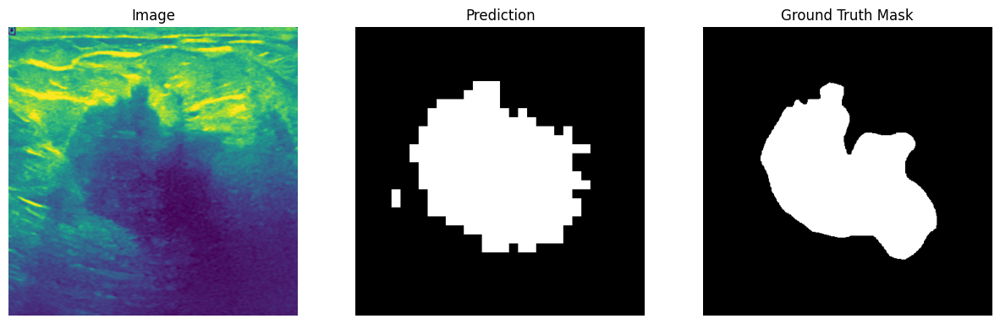

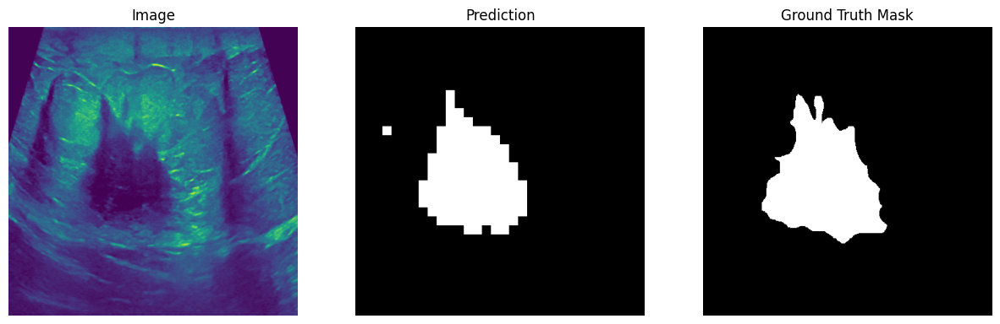

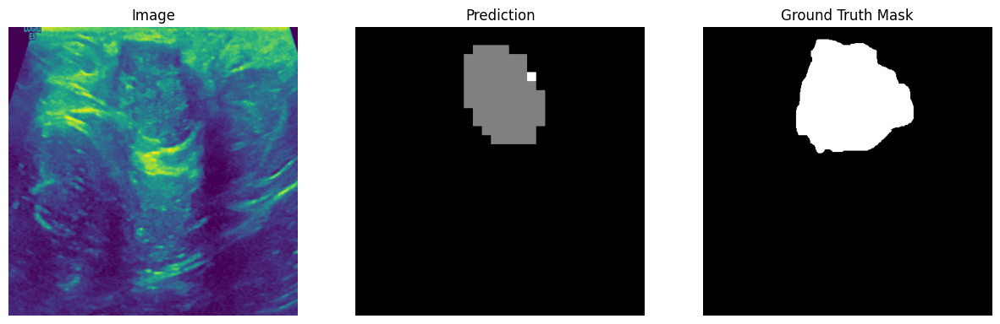

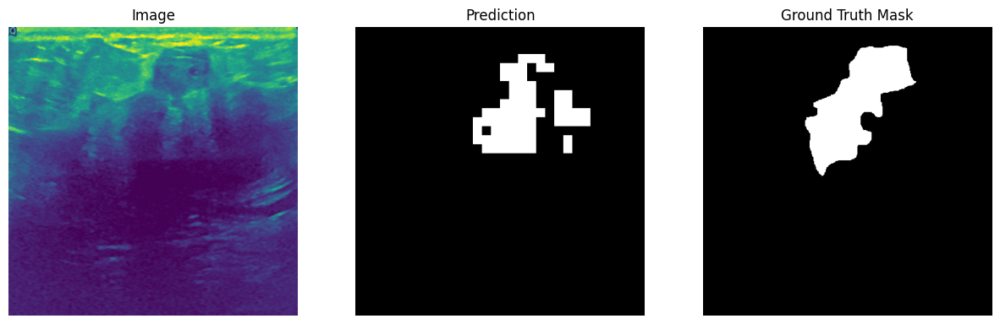

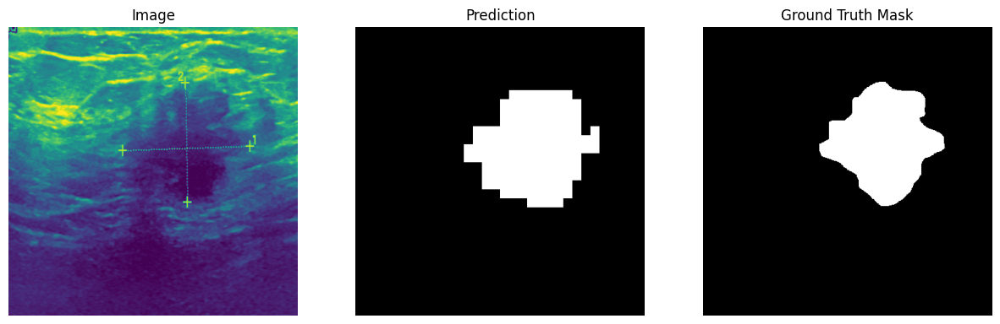

...

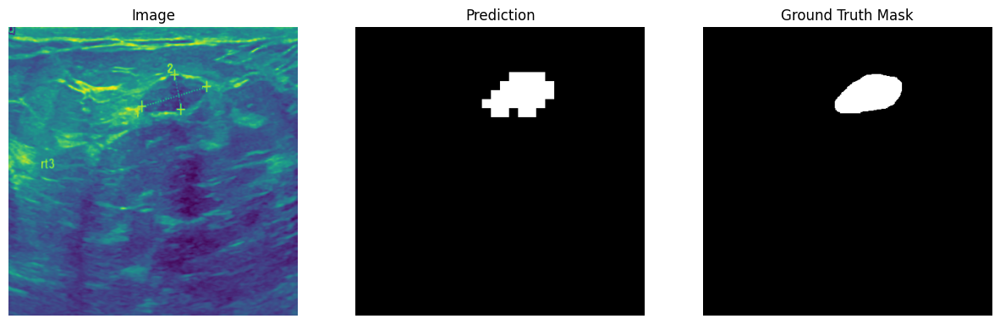

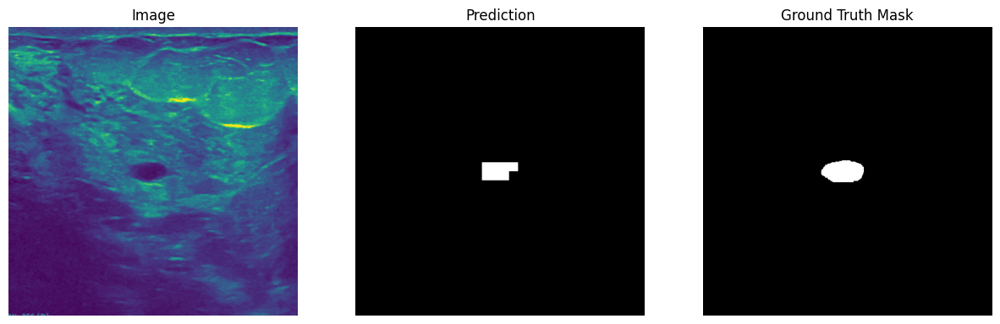

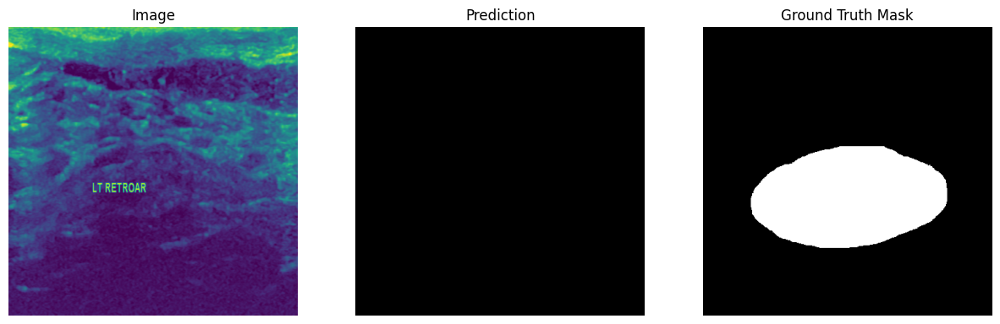

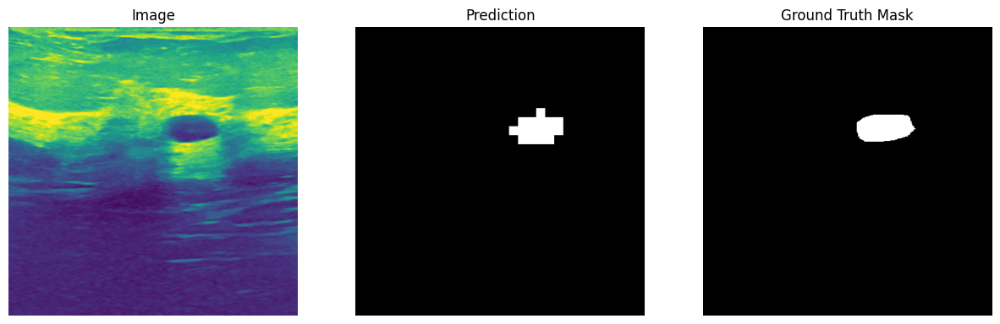

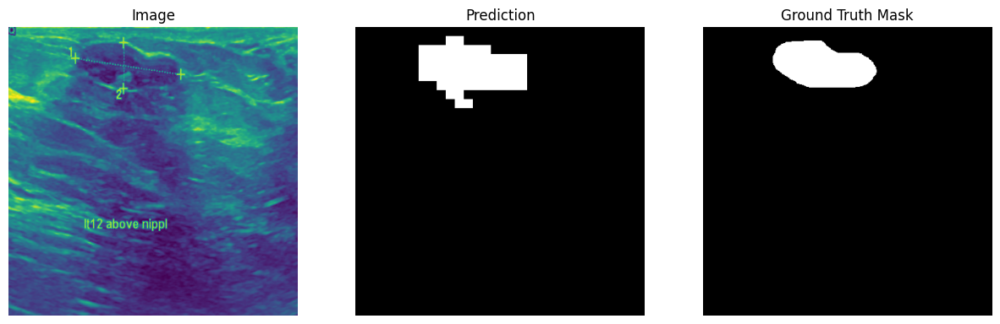

IndexError: index 12 is out of bounds for dimension 0 with size 12

In [35]:
dinov2_vits14 = torch.hub.load('facebookresearch/dinov2', 'dinov2_vits14')
model = LinearHead(dinov2_vits14, 3, input_dim, 3).to(device)
model.load_state_dict(torch.load("model_3_CANCER.pth"))
with torch.no_grad():
    for i, (imgs, mask) in enumerate(val_loader):
        imgs = imgs.to(device)
        mask = mask.to(device).squeeze(1)
        
        outputs = model(imgs, num_layers)

        outputs = outputs.view(-1, num_classes)
        

        
        preds = torch.argmax(outputs, dim=1)



        preds = preds.view(-1, int(32), int(32))
        resize = transforms.Resize(mask.shape[2], interpolation=transforms.InterpolationMode.NEAREST_EXACT)
        
        preds = resize(preds)


        #dice_metric.update(preds, mask)
        
        for i in range(batch_size):
            plot_image_prediction_and_mask(imgs[i], preds[i], mask[i])



In [30]:
def print_average_parameter_value(model):
    total_sum = 0
    total_params = 0

    for param in model.parameters():
        total_sum += param.sum().item()
        total_params += param.numel()

    average_value = total_sum / total_params if total_params > 0 else 0
    print(f"Average parameter value: {average_value:.4f}")

print_average_parameter_value(model)

Average parameter value: 0.0003


In [31]:
def print_average_grad_parameter_value(model):
    total_sum = 0
    total_params = 0

    for param in model.parameters():
        if param.requires_grad:  # Only include parameters with gradients
            total_sum += param.sum().item()
            total_params += param.numel()

    average_value = total_sum / total_params if total_params > 0 else 0
    print(f"Average value of parameters with requires_grad=True: {average_value:.5f}")

print_average_grad_parameter_value(model)

Average value of parameters with requires_grad=True: 0.00004


In [1]:
dinov2_vits14 = torch.hub.load('facebookresearch/dinov2', 'dinov2_vits14')
model = LinearHead(dinov2_vits14, 20, input_dim, 2).to(device)
model.load_state_dict(torch.load("model_r1_LUNG.pth"))
print_average_parameter_value(model)
print_average_grad_parameter_value(model)

NameError: name 'torch' is not defined